In [18]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib.pyplot as plt
from scipy import stats

In [2]:
df_train = pd.read_csv('train.csv')
df_client = pd.read_csv('client.csv')

display(df_train.head(3))
print(df_train.shape)

display(df_client.head(3))
print(df_client.shape)

,county,is_business,product_type,target,is_consumption,datetime,data_block_id,row_id,prediction_unit_id
0,0,0,1,0.713,0,2021-09-01 00:00:00,0,0,0
1,0,0,1,96.590,1,2021-09-01 00:00:00,0,1,0
2,0,0,2,0.000,0,2021-09-01 00:00:00,0,2,1


(2018352, 9)


,product_type,county,eic_count,installed_capacity,is_business,date,data_block_id
0,1,0,108,952.89,0,2021-09-01,2
1,2,0,17,166.40,0,2021-09-01,2
2,3,0,688,7207.88,0,2021-09-01,2


(41919, 7)


In [3]:
df_train['county'].unique()

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15])

In [4]:
df_train['product_type'].unique()

array([1, 2, 3, 0])

In [5]:
df_train['datetime'].min()

'2021-09-01 00:00:00'

In [6]:
df_train['datetime'].max()

'2023-05-31 23:00:00'

<Axes: >

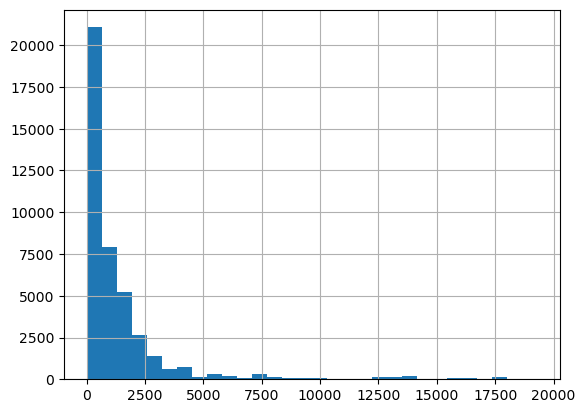

In [7]:
df_client['installed_capacity'].hist(bins=30)

In [8]:
df_train = df_train.merge(df_client, how='left', on=["county", "is_business", "product_type", "data_block_id"])
df_train['target_norm'] = df_train['target'] / df_train['installed_capacity']
df_train['target_norm_log'] = np.log1p(df_train['target_norm'])
df_train['target_log'] = np.log1p(df_train['target'])
df_train.head()

,county,is_business,product_type,target,is_consumption,datetime,data_block_id,row_id,prediction_unit_id,eic_count,installed_capacity,date,target_norm,target_norm_log,target_log
0,0,0,1,0.713,0,2021-09-01 00:00:00,0,0,0,NaN,NaN,NaN,NaN,NaN,0.538246
1,0,0,1,96.590,1,2021-09-01 00:00:00,0,1,0,NaN,NaN,NaN,NaN,NaN,4.580775
2,0,0,2,0.000,0,2021-09-01 00:00:00,0,2,1,NaN,NaN,NaN,NaN,NaN,0.000000
3,0,0,2,17.314,1,2021-09-01 00:00:00,0,3,1,NaN,NaN,NaN,NaN,NaN,2.907666
4,0,0,3,2.904,0,2021-09-01 00:00:00,0,4,2,NaN,NaN,NaN,NaN,NaN,1.362002


In [9]:
df_train.isna().sum()

county                   0
is_business              0
product_type             0
target                 528
is_consumption           0
datetime                 0
data_block_id            0
row_id                   0
prediction_unit_id       0
eic_count             8640
installed_capacity    8640
date                  8640
target_norm           9168
target_norm_log       9168
target_log             528
dtype: int64

In [10]:
df_train = df_train.dropna()

In [11]:
def plot_data_product(county, is_business, is_consumption, target='target', df=df_train):
    """ Plotly express lineplot for datetime vs target for all product types. """
    data = df[(df['county'] == county) 
        & (df['is_business'] == is_business) 
        & (df['is_consumption'] == is_consumption)]

    fig = px.line(
        data, x='datetime', y=target, color='product_type',
        title=f"county = {county} is_business = {is_business} is_consumption = {is_consumption}"
    )
    fig.show()

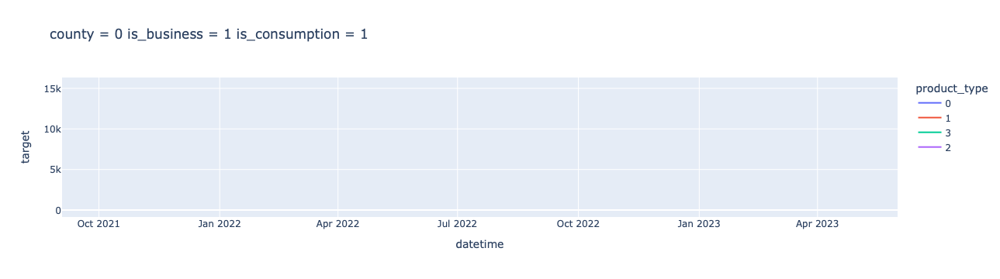

In [22]:
plot_data_product(county=0, 
          is_business=1,
          is_consumption=1,
          target='target', 
          df=df_train)

In [13]:
def plot_data_county(product_type, is_business, is_consumption, target='target', df=df_train):
    """ plotly express lineplot for datetime vs target for all counties """
    data = df[(df['product_type'] == product_type) 
        & (df['is_business'] == is_business) 
        & (df['is_consumption'] == is_consumption)]

    fig = px.line(
        data, x='datetime', y=target, color='county',
        title=f"product_type={product_type} --- is_business={is_business} --- is_consumption={is_consumption}"
    )
    fig.show()

In [45]:
plot_data_county(product_type=3, 
          is_business=1,
          is_consumption=0,
          target='target', 
          df=df_train)

<Axes: ylabel='Density'>

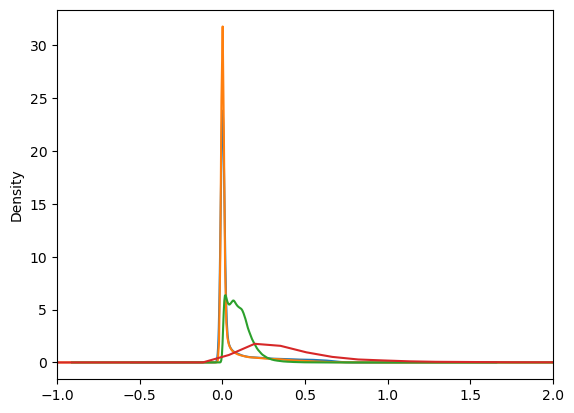

In [15]:
df_train.target_norm[(df_train.is_consumption==0) & (df_train.is_business==0)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==0) & (df_train.is_business==1)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==1) & (df_train.is_business==0)].plot(kind = 'kde', xlim=(-1, 2))
df_train.target_norm[(df_train.is_consumption==1) & (df_train.is_business==1)].plot(kind = 'kde', xlim=(-1, 2))

<Axes: ylabel='Density'>

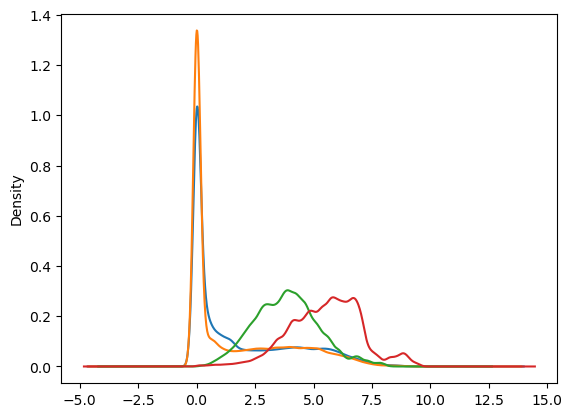

In [16]:
df_train.target_log[(df_train.is_consumption==0) & (df_train.is_business==0)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==0) & (df_train.is_business==1)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==1) & (df_train.is_business==0)].plot(kind = 'kde',) #xlim=(-1, 2))
df_train.target_log[(df_train.is_consumption==1) & (df_train.is_business==1)].plot(kind = 'kde',) #xlim=(-1, 2))

In [17]:
for i in [0, 1]:
    for j in [0, 1]:
        print(df_train[(df_train.is_consumption==i) & (df_train.is_business==j)].shape[0])

465429
539163
465429
539163
